In [1]:
from ultralytics import YOLO
import os

# Set paths
base_dir = "/Users/mepercuter/Desktop/kaggle_crops/archive/yolo_data"
yaml_file = "dataset.yaml"

# Create YAML file
def create_yolo_yaml(base_dir, output_path, class_names):
    yaml_content = f"""
                # Paths to datasets
                train: {os.path.join(base_dir, 'train/images')}
                val: {os.path.join(base_dir, 'val/images')}
                test: {os.path.join(base_dir, 'test/images')}

                # Number of classes
                nc: {len(class_names)}

                # Class names
                names: {class_names}
                """
    with open(output_path, 'w') as f:
        f.write(yaml_content.strip())

# Create YAML configuration file
class_names = ["Crop", "Weed"]
yaml_path = os.path.join(base_dir, yaml_file)
create_yolo_yaml(base_dir, yaml_path, class_names)

# Load YOLOv8 model
model = YOLO("yolov8n.pt")  # You can choose other YOLOv8 versions like "yolov8s.pt" or "yolov8m.pt"

# Train the model
model.train(
    data=yaml_path,       # Path to dataset YAML file
    epochs=10,            # Number of epochs
    batch=8,             # Batch size
    imgsz=512,            # Image size
    device="mps",        # Use "cpu" or "cuda" explicitly if needed
    workers=4,            # Number of DataLoader workers
    name="weed_crop_model",  # Name of the run
    project="runs/detect",   # Directory where results will be saved
    verbose=True          # Print training details
)

# Validation
metrics = model.val(data=yaml_path, imgsz=512, conf=0.5)
print("Validation Metrics:", metrics)

# Testing/Inference
metrics = model.val(data=yaml_path, split='test', imgsz=512)
print("Test Metrics:", metrics)

# Save the trained model
model_path = "weed_crop_model.pt"
model.export(format="torchscript", dynamic=True, simplify=True, device="mps", opset=12)
print(f"Model saved at {model_path}")


Ultralytics 8.3.34 🚀 Python-3.8.18 torch-1.13.1 CPU (Apple M1)
WARNING ⚠️ Upgrade to torch>=2.0.0 for deterministic training.
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/Users/mepercuter/Desktop/kaggle_crops/archive/yolo_data/dataset.yaml, epochs=10, time=None, patience=100, batch=8, imgsz=512, save=True, save_period=-1, cache=False, device=mps, workers=4, project=runs/detect, name=weed_crop_model5, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frame

train: Scanning /Users/mepercuter/Desktop/kaggle_crops/archive/yolo_data/train/labels.cache... 910 images, 0 backgrounds, 0 corrupt: 100%|██████████| 910/910 [00:00<?, ?it/s]
val: Scanning /Users/mepercuter/Desktop/kaggle_crops/archive/yolo_data/val/labels.cache... 261 images, 0 backgrounds, 0 corrupt: 100%|██████████| 261/261 [00:00<?, ?it/s]


Plotting labels to runs/detect/weed_crop_model5/labels.jpg... 
"No such keys(s): 'mode.use_inf_as_null'"
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 512 train, 512 val
Using 0 dataloader workers
Logging results to runs/detect/weed_crop_model5
Starting training for 10 epochs...
Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/10         0G      1.339       2.41      1.685         16        512: 100%|██████████| 114/114 [02:05<00:00,  1.10s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:33<00:00,  2.00s/it]

                   all        261        392       0.64      0.543      0.584       0.27



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/10         0G      1.285      1.845      1.598         18        512: 100%|██████████| 114/114 [02:03<00:00,  1.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:33<00:00,  1.97s/it]

                   all        261        392      0.482      0.626      0.589      0.311



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/10         0G      1.296      1.649      1.588         13        512: 100%|██████████| 114/114 [02:11<00:00,  1.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:37<00:00,  2.23s/it]

                   all        261        392       0.71       0.57      0.688      0.375



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/10         0G      1.283      1.438      1.577         16        512: 100%|██████████| 114/114 [02:30<00:00,  1.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:35<00:00,  2.07s/it]

                   all        261        392      0.752      0.686      0.755      0.422



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/10         0G      1.221      1.281      1.524          8        512: 100%|██████████| 114/114 [02:04<00:00,  1.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:33<00:00,  1.97s/it]

                   all        261        392      0.744      0.713      0.766      0.441



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/10         0G      1.213      1.198      1.516          7        512: 100%|██████████| 114/114 [02:02<00:00,  1.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:32<00:00,  1.91s/it]

                   all        261        392      0.653      0.734      0.666      0.365



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/10         0G      1.165      1.118      1.487          6        512: 100%|██████████| 114/114 [02:09<00:00,  1.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:33<00:00,  1.97s/it]

                   all        261        392      0.785      0.774      0.833      0.507



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/10         0G      1.123      1.013      1.437         21        512: 100%|██████████| 114/114 [02:11<00:00,  1.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:32<00:00,  1.94s/it]

                   all        261        392      0.805      0.801      0.794      0.471



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/10         0G      1.105     0.9561      1.422          7        512: 100%|██████████| 114/114 [02:13<00:00,  1.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:32<00:00,  1.92s/it]

                   all        261        392      0.882      0.748      0.846      0.542



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/10         0G      1.061     0.9127      1.388         11        512: 100%|██████████| 114/114 [02:07<00:00,  1.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:33<00:00,  1.97s/it]

                   all        261        392      0.888      0.766      0.861      0.553



10 epochs completed in 0.457 hours.
Optimizer stripped from runs/detect/weed_crop_model5/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/weed_crop_model5/weights/best.pt, 6.2MB

Validating runs/detect/weed_crop_model5/weights/best.pt...
Ultralytics 8.3.34 🚀 Python-3.8.18 torch-1.13.1 CPU (Apple M1)
Model summary (fused): 168 layers, 3,006,038 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:32<00:00,  1.91s/it]


                   all        261        392      0.891      0.766      0.861      0.553
                  Crop        125        221      0.851      0.738      0.868      0.583
                  Weed        137        171      0.931      0.795      0.854      0.524
Speed: 0.5ms preprocess, 120.0ms inference, 0.0ms loss, 0.3ms postprocess per image
Results saved to runs/detect/weed_crop_model5
Ultralytics 8.3.34 🚀 Python-3.8.18 torch-1.13.1 CPU (Apple M1)
Model summary (fused): 168 layers, 3,006,038 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /Users/mepercuter/Desktop/kaggle_crops/archive/yolo_data/val/labels.cache... 261 images, 0 backgrounds, 0 corrupt: 100%|██████████| 261/261 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 33/33 [00:14<00:00,  2.26it/s]


                   all        261        392      0.891      0.766      0.853      0.595
                  Crop        125        221      0.851      0.738      0.845      0.618
                  Weed        137        171      0.931      0.795      0.861      0.571
Speed: 0.4ms preprocess, 51.8ms inference, 0.0ms loss, 0.2ms postprocess per image
Results saved to runs/detect/weed_crop_model52
Validation Metrics: ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x16d102a00>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017, 

val: Scanning /Users/mepercuter/Desktop/kaggle_crops/archive/yolo_data/test/labels.cache... 129 images, 0 backgrounds, 0 corrupt: 100%|██████████| 129/129 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:07<00:00,  2.36it/s]


                   all        129        195      0.862      0.764      0.866       0.58
                  Crop         64        108      0.783      0.796      0.862      0.599
                  Weed         65         87      0.941      0.733       0.87       0.56
Speed: 0.5ms preprocess, 51.5ms inference, 0.0ms loss, 0.3ms postprocess per image
Results saved to runs/detect/weed_crop_model53
Test Metrics: ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x16d4865b0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.0


image 1/1 /Users/mepercuter/Desktop/kaggle_crops/archive/yolo_data/test/images/agri_0_1590.jpeg: 512x512 3 Weeds, 56.6ms
Speed: 1.4ms preprocess, 56.6ms inference, 0.4ms postprocess per image at shape (1, 3, 512, 512)


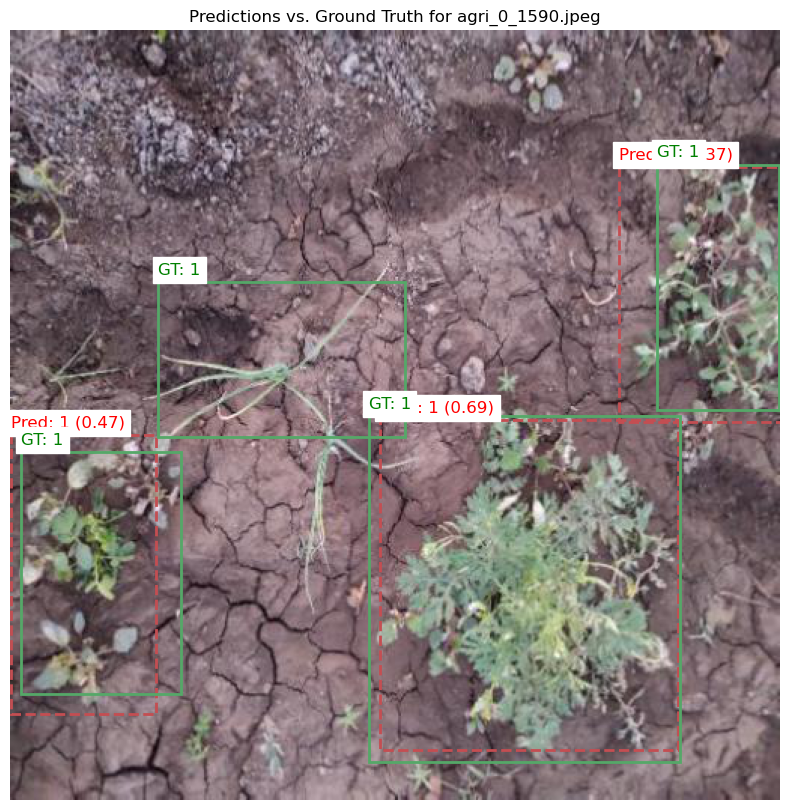


image 1/1 /Users/mepercuter/Desktop/kaggle_crops/archive/yolo_data/test/images/agri_0_1990.jpeg: 512x512 2 Crops, 131.1ms
Speed: 0.7ms preprocess, 131.1ms inference, 0.4ms postprocess per image at shape (1, 3, 512, 512)


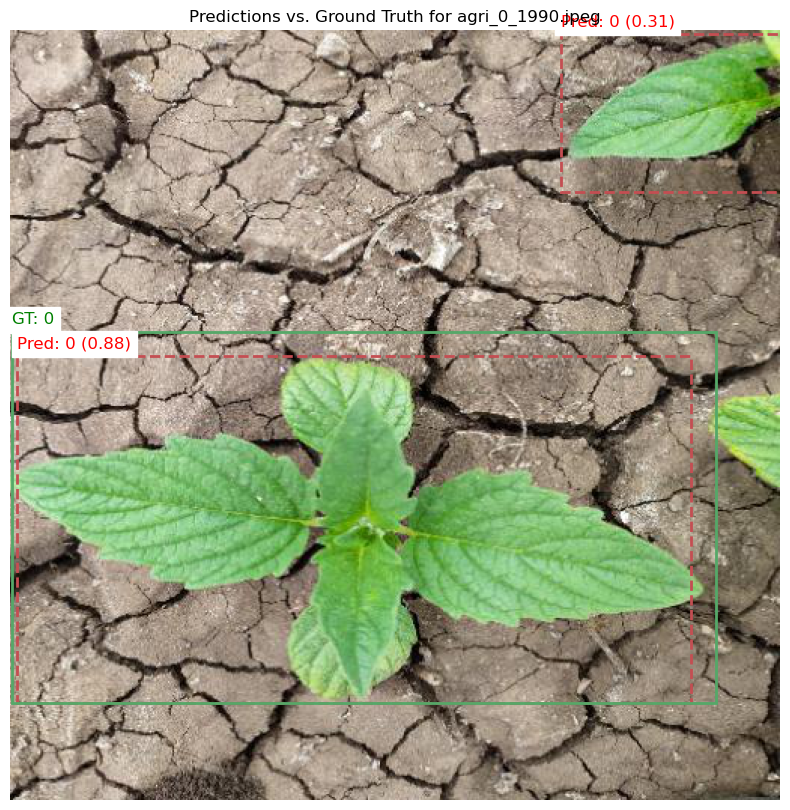


image 1/1 /Users/mepercuter/Desktop/kaggle_crops/archive/yolo_data/test/images/agri_0_5802.jpeg: 512x512 1 Crop, 149.9ms
Speed: 0.8ms preprocess, 149.9ms inference, 0.3ms postprocess per image at shape (1, 3, 512, 512)


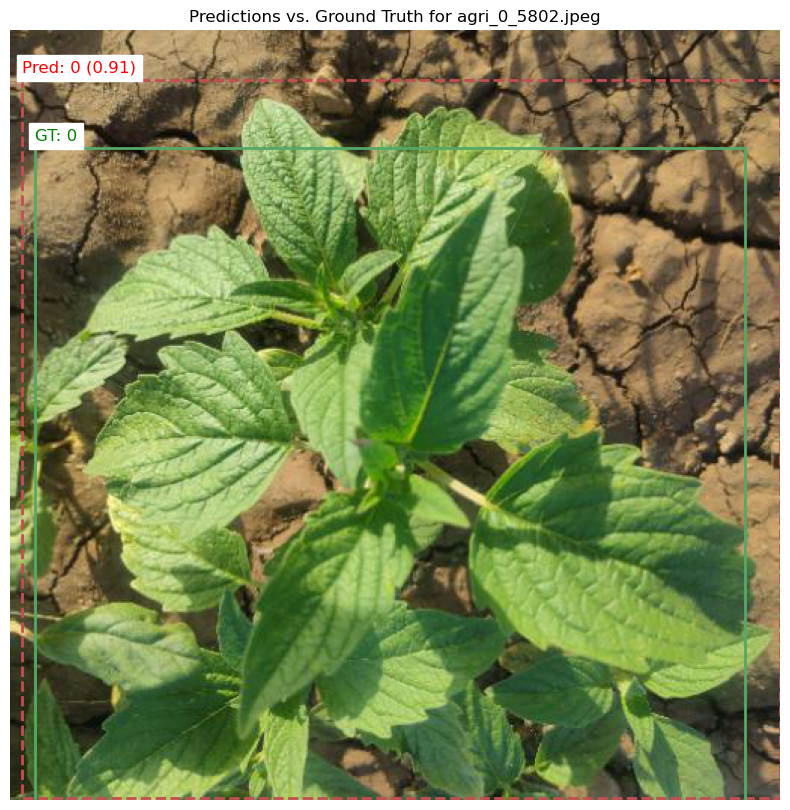


image 1/1 /Users/mepercuter/Desktop/kaggle_crops/archive/yolo_data/test/images/agri_0_2040.jpeg: 512x512 1 Weed, 190.8ms
Speed: 0.8ms preprocess, 190.8ms inference, 0.3ms postprocess per image at shape (1, 3, 512, 512)


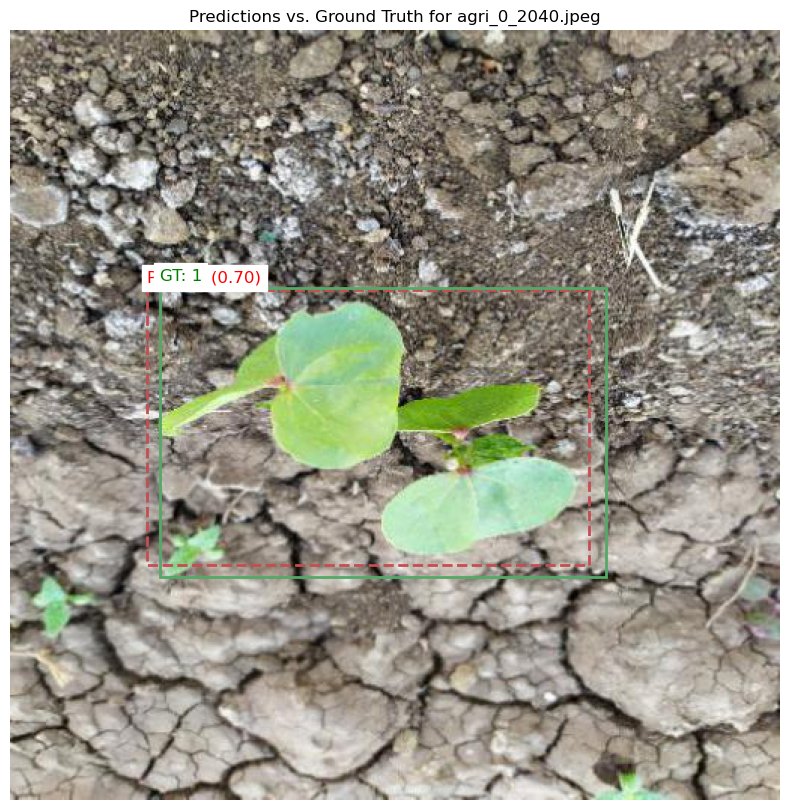


image 1/1 /Users/mepercuter/Desktop/kaggle_crops/archive/yolo_data/test/images/agri_0_8267.jpeg: 512x512 3 Weeds, 76.7ms
Speed: 0.8ms preprocess, 76.7ms inference, 0.3ms postprocess per image at shape (1, 3, 512, 512)


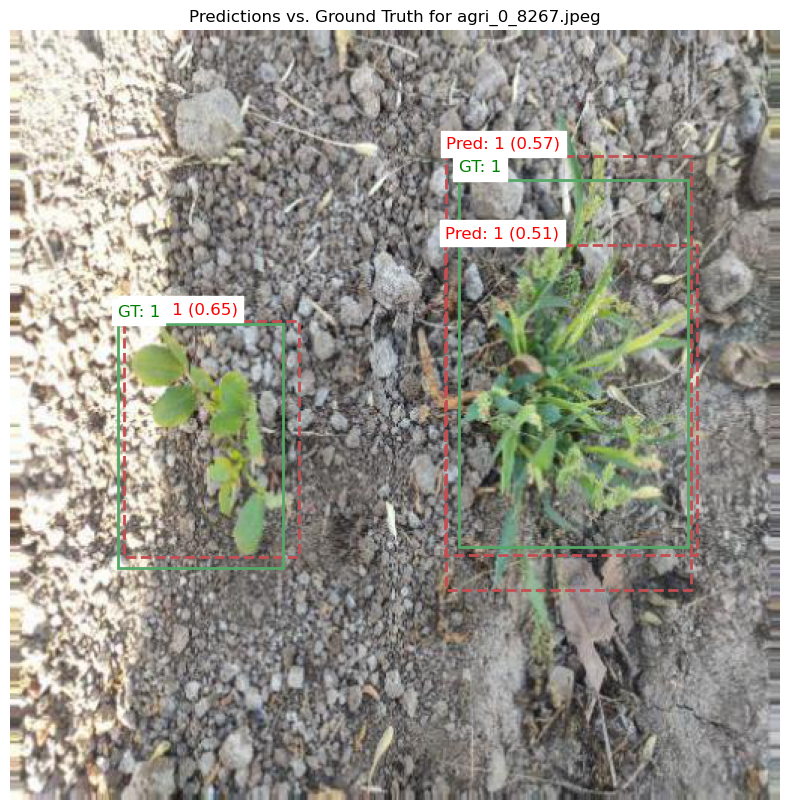


image 1/1 /Users/mepercuter/Desktop/kaggle_crops/archive/yolo_data/test/images/agri_0_2685.jpeg: 512x512 3 Weeds, 165.7ms
Speed: 0.8ms preprocess, 165.7ms inference, 0.4ms postprocess per image at shape (1, 3, 512, 512)


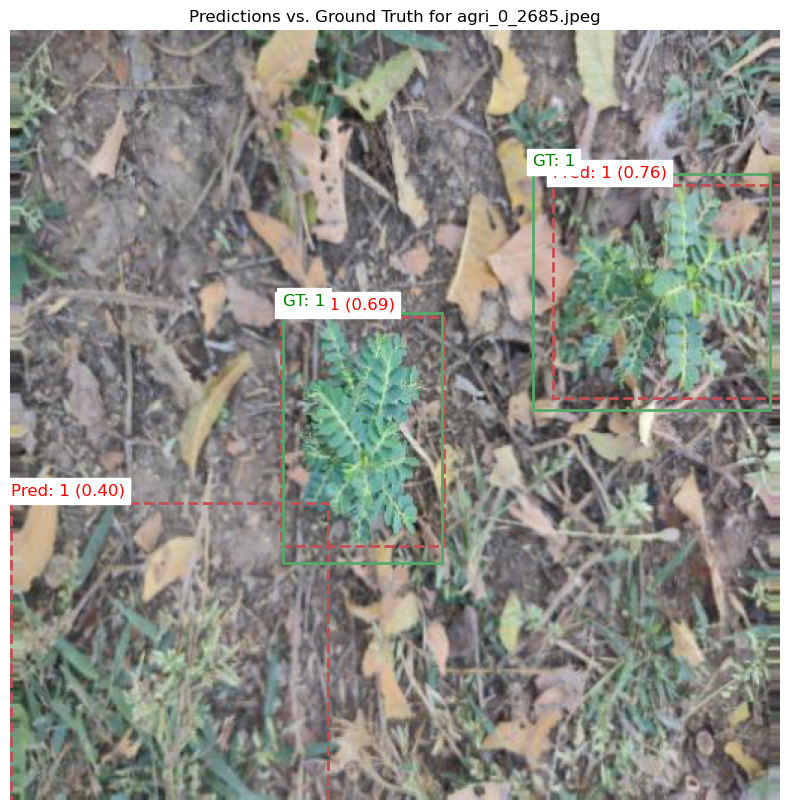


image 1/1 /Users/mepercuter/Desktop/kaggle_crops/archive/yolo_data/test/images/agri_0_3186.jpeg: 512x512 1 Weed, 164.7ms
Speed: 1.0ms preprocess, 164.7ms inference, 0.3ms postprocess per image at shape (1, 3, 512, 512)


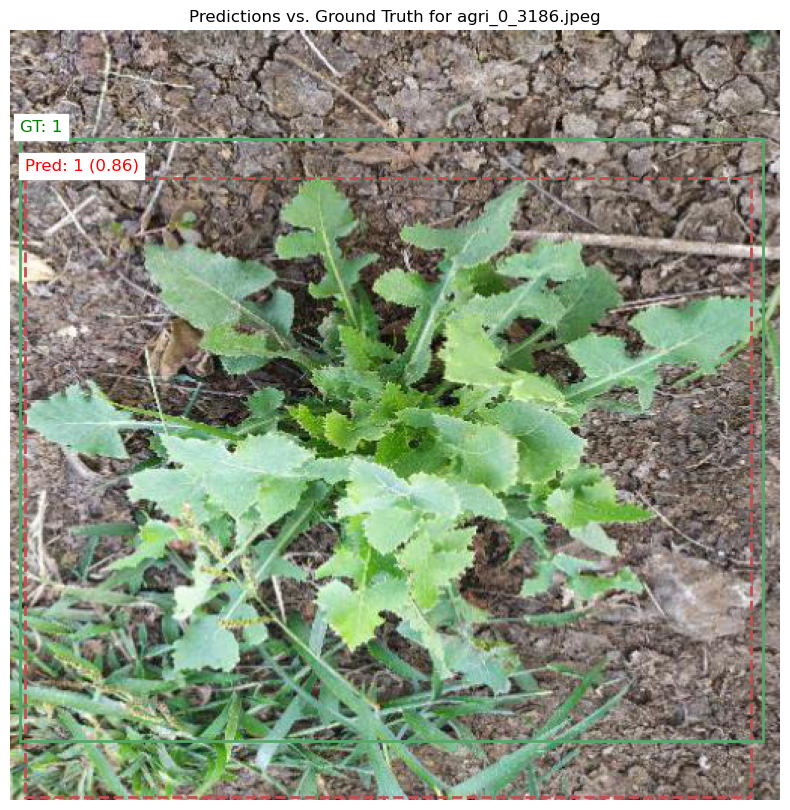


image 1/1 /Users/mepercuter/Desktop/kaggle_crops/archive/yolo_data/test/images/agri_0_5160.jpeg: 512x512 1 Weed, 182.2ms
Speed: 0.7ms preprocess, 182.2ms inference, 0.7ms postprocess per image at shape (1, 3, 512, 512)


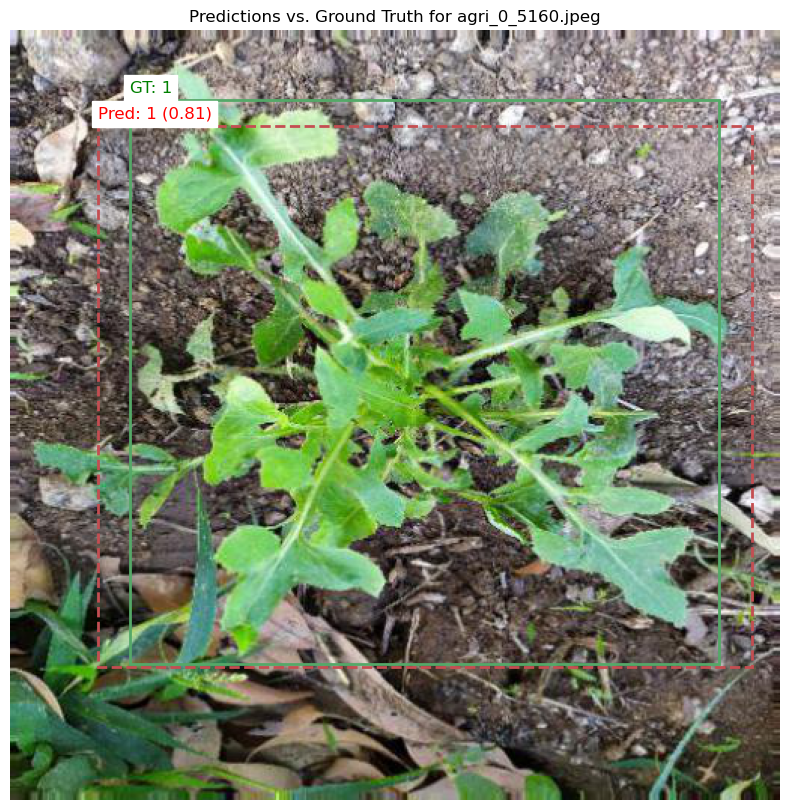


image 1/1 /Users/mepercuter/Desktop/kaggle_crops/archive/yolo_data/test/images/agri_0_618.jpeg: 512x512 2 Crops, 155.6ms
Speed: 0.7ms preprocess, 155.6ms inference, 0.8ms postprocess per image at shape (1, 3, 512, 512)


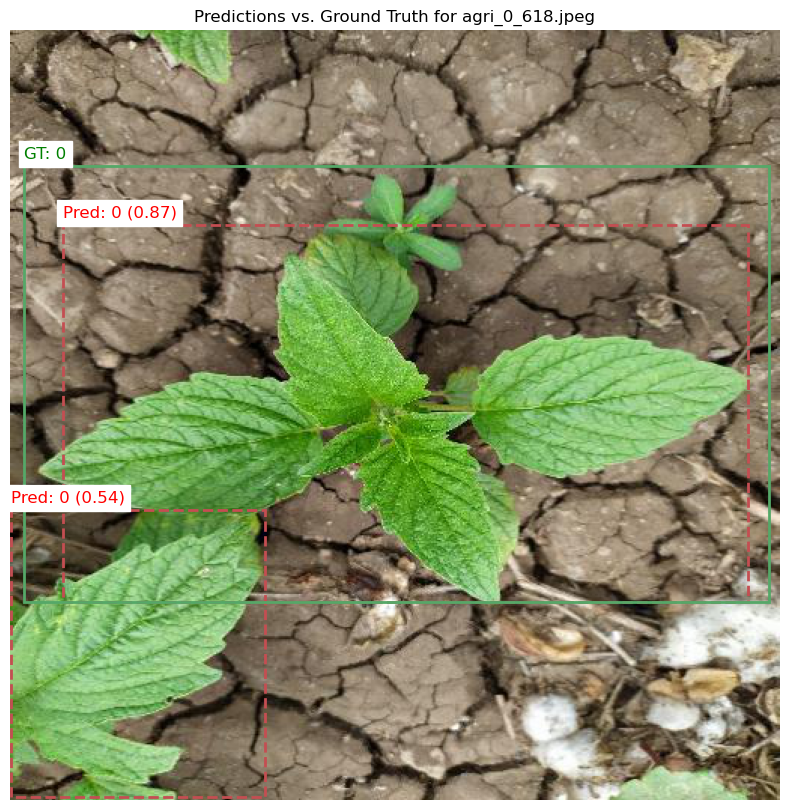


image 1/1 /Users/mepercuter/Desktop/kaggle_crops/archive/yolo_data/test/images/agri_0_5361.jpeg: 512x512 3 Crops, 185.2ms
Speed: 0.6ms preprocess, 185.2ms inference, 0.8ms postprocess per image at shape (1, 3, 512, 512)


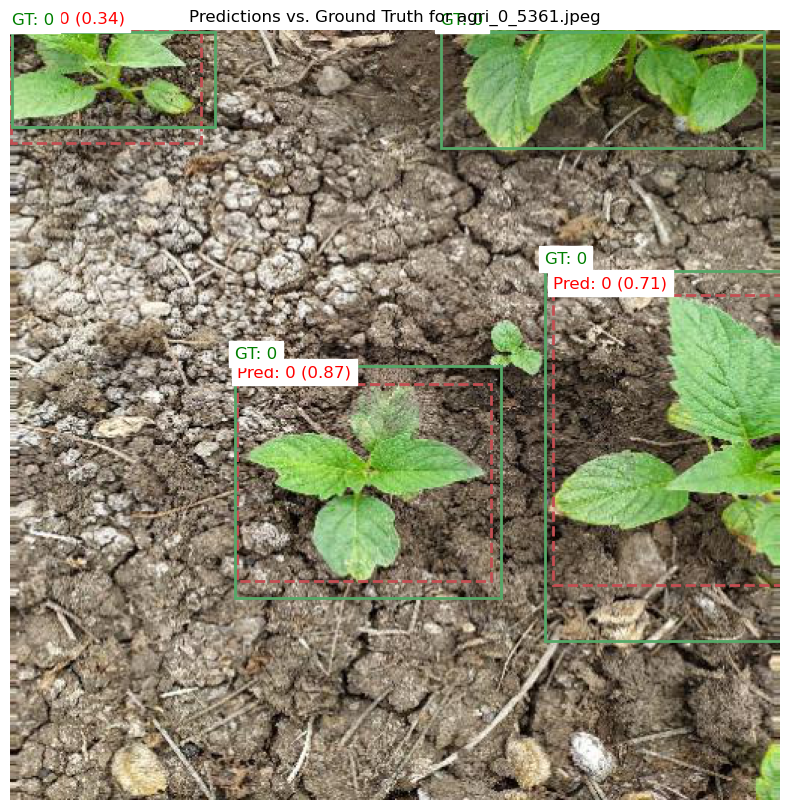

In [5]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image
import os

def visualize_predictions_with_gt(
    model, 
    image_dir, 
    label_dir, 
    img_size=(512, 512), 
    num_samples=5, 
    conf_threshold=0.5
):
    """
    Visualize images with predicted and ground truth bounding boxes.

    Args:
        model: Trained YOLO model.
        image_dir (str): Path to the directory containing test images.
        label_dir (str): Path to the directory containing test labels.
        img_size (tuple): Resize dimensions for the images.
        num_samples (int): Number of samples to visualize.
        conf_threshold (float): Confidence threshold for predictions.
    """
    image_files = [
        f for f in os.listdir(image_dir) if f.endswith(('.png', '.jpg', '.jpeg'))
    ]
    
    for i, image_file in enumerate(image_files[:num_samples]):
        # Load and preprocess the image
        image_path = os.path.join(image_dir, image_file)
        label_path = os.path.join(label_dir, image_file.replace('.jpeg', '.txt')
                                  .replace('.jpg', '.txt').replace('.png', '.txt'))
        image = Image.open(image_path).convert("RGB")
        original_size = image.size  # Save original dimensions
        image_resized = image.resize(img_size)
        
        # Perform inference
        results = model.predict(source=image_path, conf=conf_threshold, imgsz=img_size, device="cpu")
        predictions = results[0].boxes  # Get predictions for this image
        
        pred_bboxes = predictions.xyxy.cpu().numpy()  # Predicted (x_min, y_min, x_max, y_max)
        pred_scores = predictions.conf.cpu().numpy()  # Confidence scores
        pred_labels = predictions.cls.cpu().numpy()  # Predicted class labels

        # Load ground truth
        gt_bboxes = []
        gt_labels = []
        if os.path.exists(label_path):
            with open(label_path, 'r') as f:
                for line in f:
                    data = line.strip().split()
                    class_id = int(data[0])
                    x_center, y_center, box_width, box_height = map(float, data[1:])
                    
                    # Convert YOLO format to (x_min, y_min, x_max, y_max)
                    x_min = (x_center - box_width / 2) * img_size[0]
                    y_min = (y_center - box_height / 2) * img_size[1]
                    x_max = (x_center + box_width / 2) * img_size[0]
                    y_max = (y_center + box_height / 2) * img_size[1]
                    
                    gt_bboxes.append([x_min, y_min, x_max, y_max])
                    gt_labels.append(class_id)
        
        # Plot the image with predicted and ground truth bounding boxes
        fig, ax = plt.subplots(1, 1, figsize=(10, 10))
        ax.imshow(image_resized)
        
        # Plot predicted boxes
        for bbox, score, label in zip(pred_bboxes, pred_scores, pred_labels):
            x_min, y_min, x_max, y_max = bbox
            width, height = x_max - x_min, y_max - y_min
            rect = patches.Rectangle(
                (x_min, y_min), width, height, 
                linewidth=2, edgecolor='r', facecolor='none', linestyle="--"
            )
            ax.add_patch(rect)
            ax.text(
                x_min, y_min - 5,
                f"Pred: {int(label)} ({score:.2f})",
                color='red',
                fontsize=12,
                backgroundcolor='white'
            )
        
        # Plot ground truth boxes
        for bbox, label in zip(gt_bboxes, gt_labels):
            x_min, y_min, x_max, y_max = bbox
            width, height = x_max - x_min, y_max - y_min
            rect = patches.Rectangle(
                (x_min, y_min), width, height, 
                linewidth=2, edgecolor='g', facecolor='none'
            )
            ax.add_patch(rect)
            ax.text(
                x_min, y_min - 5,
                f"GT: {int(label)}",
                color='green',
                fontsize=12,
                backgroundcolor='white'
            )
        
        plt.title(f"Predictions vs. Ground Truth for {image_file}")
        plt.axis('off')
        plt.show()

# Specify directories and visualize
test_image_dir = "/Users/mepercuter/Desktop/kaggle_crops/archive/yolo_data/test/images"  # Replace with your test image directory
test_label_dir = "/Users/mepercuter/Desktop/kaggle_crops/archive/yolo_data/test/labels"  # Replace with your test label directory
visualize_predictions_with_gt(model, test_image_dir, test_label_dir, img_size=(512, 512), num_samples=10, conf_threshold=0.3)

# Helper function - yolo split

In [3]:
import os
import shutil
from sklearn.model_selection import train_test_split

# Define the paths
base_dir = "/Users/mepercuter/Desktop/kaggle_crops/archive/agri_data/data"  # Replace with the path to your folder
output_dir = "/Users/mepercuter/Desktop/kaggle_crops/archive/yolo_data"  # Replace with where you want the organized dataset

# Create train, val, and test directories
train_img_dir = os.path.join(output_dir, "train/images")
train_lbl_dir = os.path.join(output_dir, "train/labels")
val_img_dir = os.path.join(output_dir, "val/images")
val_lbl_dir = os.path.join(output_dir, "val/labels")
test_img_dir = os.path.join(output_dir, "test/images")
test_lbl_dir = os.path.join(output_dir, "test/labels")

os.makedirs(train_img_dir, exist_ok=True)
os.makedirs(train_lbl_dir, exist_ok=True)
os.makedirs(val_img_dir, exist_ok=True)
os.makedirs(val_lbl_dir, exist_ok=True)
os.makedirs(test_img_dir, exist_ok=True)
os.makedirs(test_lbl_dir, exist_ok=True)

# Get all image-label pairs
all_images = [f for f in os.listdir(base_dir) if f.endswith(('.jpg', '.jpeg', '.png'))]
all_labels = [f for f in os.listdir(base_dir) if f.endswith('.txt')]

# Sort to ensure corresponding order
all_images.sort()
all_labels.sort()

# Ensure each image has a corresponding label
assert len(all_images) == len(all_labels), "Number of images and labels do not match!"
for img, lbl in zip(all_images, all_labels):
    assert img.split('.')[0] == lbl.split('.')[0], f"Image {img} and Label {lbl} mismatch!"

# Split dataset into train, val, and test
train_imgs, temp_imgs, train_lbls, temp_lbls = train_test_split(all_images, all_labels, test_size=0.3, random_state=42)
val_imgs, test_imgs, val_lbls, test_lbls = train_test_split(temp_imgs, temp_lbls, test_size=0.33, random_state=42)

# Move files to respective directories
for img, lbl in zip(train_imgs, train_lbls):
    shutil.copy(os.path.join(base_dir, img), train_img_dir)
    shutil.copy(os.path.join(base_dir, lbl), train_lbl_dir)

for img, lbl in zip(val_imgs, val_lbls):
    shutil.copy(os.path.join(base_dir, img), val_img_dir)
    shutil.copy(os.path.join(base_dir, lbl), val_lbl_dir)

for img, lbl in zip(test_imgs, test_lbls):
    shutil.copy(os.path.join(base_dir, img), test_img_dir)
    shutil.copy(os.path.join(base_dir, lbl), test_lbl_dir)

print(f"Dataset organized successfully!")
print(f"Train images: {len(train_imgs)}, Train labels: {len(train_lbls)}")
print(f"Validation images: {len(val_imgs)}, Validation labels: {len(val_lbls)}")
print(f"Test images: {len(test_imgs)}, Test labels: {len(test_lbls)}")


Dataset organized successfully!
Train images: 910, Train labels: 910
Validation images: 261, Validation labels: 261
Test images: 129, Test labels: 129


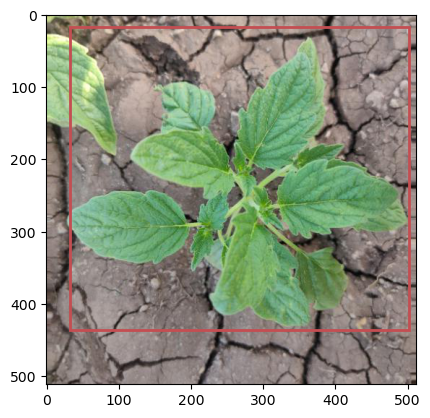

In [4]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image

# Example image and label
image_path = "/Users/mepercuter/Desktop/kaggle_crops/archive/yolo_data/train/images/agri_0_60.jpeg"
label = [0, 0.521484, 0.443359, 0.917969, 0.820312]  # Replace with your label

# Load the image
image = Image.open(image_path)
width, height = image.size

# Convert normalized bbox to pixel coordinates
x_center, y_center, bbox_width, bbox_height = label[1:]
x_center *= width
y_center *= height
bbox_width *= width
bbox_height *= height

# Get corners of the bounding box
x_min = x_center - bbox_width / 2
y_min = y_center - bbox_height / 2
x_max = x_center + bbox_width / 2
y_max = y_center + bbox_height / 2

# Plot the image and bounding box
fig, ax = plt.subplots(1)
ax.imshow(image)
rect = patches.Rectangle(
    (x_min, y_min), bbox_width, bbox_height,
    linewidth=2, edgecolor="r", facecolor="none"
)
ax.add_patch(rect)
plt.show()


# Custom CNN

In [21]:
import os
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from pytorch_lightning import LightningModule, Trainer
from pytorch_lightning.callbacks import ModelCheckpoint, EarlyStopping
from torchvision.transforms.functional import to_tensor
from PIL import Image
import yaml
from torchvision import transforms
import matplotlib.pyplot as plt
import numpy as np

# Custom Dataset for YOLO format
class SingleBoundingBoxDataset(Dataset):
    def __init__(self, image_dir, label_dir, img_size=(224, 224), transform=None):
        self.image_dir = image_dir
        self.label_dir = label_dir
        self.img_size = img_size
        self.transform = transform
        self.image_files = [
            f for f in os.listdir(image_dir) if f.endswith(('.png', '.jpg', '.jpeg'))
        ]

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, idx):
        image_path = os.path.join(self.image_dir, self.image_files[idx])
        label_path = os.path.join(self.label_dir, self.image_files[idx].replace('.jpeg', '.txt')
                                  .replace('.jpg', '.txt').replace('.png', '.txt'))

        # Load and preprocess the image
        image = Image.open(image_path).convert("RGB")
        image = image.resize(self.img_size)
        if self.transform:
            image = self.transform(image)

        # Load and preprocess labels
        bboxes = []
        label_present = False
        if os.path.exists(label_path):
            with open(label_path, 'r') as f:
                for line in f:
                    data = line.strip().split()
                    class_id = int(data[0])
                    x_center, y_center, box_width, box_height = map(float, data[1:])
                    bboxes.append([x_center, y_center, box_width, box_height])
            
            # Only keep instances with one bounding box
            if len(bboxes) == 1:
                label_present = True
                bboxes = torch.tensor(bboxes, dtype=torch.float32)
            else:
                bboxes = torch.zeros((1, 4), dtype=torch.float32)

        # Add a flag to indicate the presence of a bounding box
        return image, {"labels": class_id, "boxes": bboxes, "present": label_present}

# Updated transforms with normalization
mean = [0.485, 0.456, 0.406]
std = [0.229, 0.224, 0.225]
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=mean, std=std)
])

In [22]:
from sklearn.metrics import confusion_matrix, classification_report
import seaborn as sns
class BoundingBoxCNN(LightningModule):
    def __init__(self, num_classes=2):
        super().__init__()
        self.num_classes = num_classes
        self.test_preds = []
        self.test_targets = []

        # Define a CNN architecture with Batch Normalization
        self.conv1 = nn.Conv2d(3, 16, kernel_size=3, stride=1, padding=1)
        self.bn1 = nn.BatchNorm2d(16)
        self.conv2 = nn.Conv2d(16, 32, kernel_size=3, stride=1, padding=1)
        self.bn2 = nn.BatchNorm2d(32)
        self.conv3 = nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1)
        self.bn3 = nn.BatchNorm2d(64)
        self.conv4 = nn.Conv2d(64, 64, kernel_size=3, stride=1, padding=1)
        self.bn4 = nn.BatchNorm2d(64)

        # Global Average Pooling
        self.gap = nn.AdaptiveAvgPool2d((4, 4))

        # Fully connected layers
        self.fc1 = nn.Linear(64*4*4, 128)
        self.dropout = nn.Dropout(0.5)  # Dropout for regularization
        self.fc_bbox = nn.Linear(128, 4)  # Output: Bounding box coordinates
        self.fc_class = nn.Linear(128, num_classes)  # Output: Class logits

    def forward(self, x):
        # Feature extraction layers
        x = F.relu(self.bn1(self.conv1(x)))
        x = F.max_pool2d(x, 2)  # Downsample
        x = F.relu(self.bn2(self.conv2(x)))
        x = F.max_pool2d(x, 2)
        x = F.relu(self.bn3(self.conv3(x)))
        x = F.max_pool2d(x, 2)
        x = F.relu(self.bn4(self.conv4(x)))

        # Global Average Pooling
        x = self.gap(x)
        x = torch.flatten(x, 1)  # Flatten for fully connected layers

        # Fully connected layers
        x = F.relu(self.fc1(x))
        x = self.dropout(x)

        # Output layers
        bbox = torch.sigmoid(self.fc_bbox(x))  # Bounding box predictions
        class_logits = self.fc_class(x)  # Class logits
        return bbox, class_logits

    def training_step(self, batch, batch_idx):
        images, targets = batch
        labels = targets["labels"]
        bboxes = targets["boxes"]
        present = targets["present"]

        # Filter instances with bounding boxes
        images_with_boxes = images[present]
        target_boxes = bboxes[present]
        target_labels = labels[present]

        if len(images_with_boxes) == 0:
            return None

        # Forward pass
        bbox_preds, class_logits = self(images_with_boxes)

        # Calculate losses
        bbox_loss = 20*F.mse_loss(bbox_preds, target_boxes.squeeze(1), reduction='none')
        class_loss = F.cross_entropy(class_logits, target_labels)
        bbox_loss_weighted = (bbox_loss * (torch.tensor([2, 2, 1, 1], device=bbox_loss.device))).mean()

        total_loss = bbox_loss_weighted + class_loss

        # Log losses
        self.log("train_bbox_loss", bbox_loss_weighted, prog_bar=True)
        self.log("train_class_loss", class_loss, prog_bar=True)
        self.log("train_loss", total_loss, prog_bar=True)
        return total_loss

    def validation_step(self, batch, batch_idx):
        images, targets = batch
        labels = targets["labels"]
        bboxes = targets["boxes"]
        present = targets["present"]

        images_with_boxes = images[present]
        target_boxes = bboxes[present]
        target_labels = labels[present]

        if len(images_with_boxes) == 0:
            return None

        # Forward pass
        bbox_preds, class_logits = self(images_with_boxes)

        # Calculate losses
        bbox_loss = 20*F.mse_loss(bbox_preds, target_boxes.squeeze(1), reduction='none')
        class_loss = F.cross_entropy(class_logits, target_labels)
        bbox_loss_weighted = (bbox_loss * (torch.tensor([2, 2, 1, 1], device=bbox_loss.device))).mean()

        total_loss = bbox_loss_weighted + class_loss

        # Log losses
        self.log("val_bbox_loss", bbox_loss_weighted, prog_bar=True)
        self.log("val_class_loss", class_loss, prog_bar=True)
        self.log("val_loss", total_loss, prog_bar=True)
        return total_loss

    def test_step(self, batch, batch_idx):
        images, targets = batch
        labels = targets["labels"]
        bboxes = targets["boxes"]
        present = targets["present"]

        images_with_boxes = images[present]
        target_boxes = bboxes[present]
        target_labels = labels[present]

        if len(images_with_boxes) == 0:
            return None

        # Forward pass
        bbox_preds, class_logits = self(images_with_boxes)
        pred_classes = torch.argmax(torch.softmax(class_logits, dim=1), dim=1)

        # Save predictions and targets for metrics computation
        self.test_preds.append(pred_classes.cpu())
        self.test_targets.append(target_labels.cpu())

        # Calculate losses
        bbox_loss = 20*F.mse_loss(bbox_preds, target_boxes.squeeze(1), reduction='none')
        class_loss = F.cross_entropy(class_logits, target_labels)
        bbox_loss_weighted = (bbox_loss * (torch.tensor([2, 2, 1, 1], device=bbox_loss.device))).mean()

        total_loss = bbox_loss_weighted + class_loss

        # Log losses
        self.log("test_bbox_loss", bbox_loss_weighted, prog_bar=True)
        self.log("test_class_loss", class_loss, prog_bar=True)
        self.log("test_loss", total_loss, prog_bar=True)

        # Visualization
        if batch_idx < 20:  # Limit visualization to the first 20 batches
            mean = [0.485, 0.456, 0.406]  # Replace with your dataset's mean
            std = [0.229, 0.224, 0.225]   # Replace with your dataset's std

            def visualize_predictions_with_gt(images, pred_boxes, pred_logits, gt_boxes, gt_labels, mean, std):
                """
                Visualizes predicted bounding boxes alongside ground truth (GT) bounding boxes.

                Args:
                    images (torch.Tensor): Batch of input images. Shape: [batch_size, 3, H, W].
                    pred_boxes (torch.Tensor): Predicted bounding boxes. Shape: [N, 4].
                    pred_logits (torch.Tensor): Predicted class logits. Shape: [N, num_classes].
                    gt_boxes (torch.Tensor): Ground truth bounding boxes. Shape: [N, 4].
                    gt_labels (torch.Tensor): Ground truth class labels. Shape: [N].
                    mean (list): Mean for normalization.
                    std (list): Std for normalization.
                """
                pred_probs = torch.softmax(pred_logits, dim=1)  # Convert logits to probabilities
                pred_classes = torch.argmax(pred_probs, dim=1)  # Get predicted classes

                for i, image in enumerate(images):
                    # De-normalize and prepare the image
                    image = image.permute(1, 2, 0).cpu().numpy()  # Convert to HWC
                    image = (image * std + mean) * 255.0
                    image = np.clip(image, 0, 255).astype(np.uint8)

                    plt.figure(figsize=(8, 8))
                    plt.imshow(image)

                    # Plot predicted bounding boxes
                    for j, box in enumerate(pred_boxes):
                        x_center, y_center, box_width, box_height = box.cpu().numpy()
                        x_min = (x_center - box_width / 2)
                        y_min = (y_center - box_height / 2)
                        x_max = (x_center + box_width / 2)
                        y_max = (y_center + box_height / 2)
                        x_min, y_min, x_max, y_max = x_min*224, y_min*224, x_max*224, y_max*224
                        print(box.cpu().numpy())
                        class_prob = pred_probs[j].max().item()  # Highest class probability
                        class_label = pred_classes[j].item()    # Predicted class

                        # Draw the predicted bounding box
                        plt.gca().add_patch(
                            plt.Rectangle(
                                (x_min, y_min),
                                x_max - x_min,
                                y_max - y_min,
                                edgecolor="red",
                                linewidth=2,
                                fill=False
                            )
                        )
                        plt.text(
                            x_min,
                            y_min - 5,
                            f"Class: {class_label}, Prob: {class_prob:.2f}",
                            color="white",
                            fontsize=12,
                            bbox=dict(facecolor="red", alpha=0.7)
                        )

                    # Plot ground truth bounding boxes
                    for k, gt_box in enumerate(gt_boxes):
                        x_center, y_center, box_width, box_height = gt_box.squeeze(0).cpu().numpy()
                        x_min = (x_center - box_width / 2)
                        y_min = (y_center - box_height / 2)
                        x_max = (x_center + box_width / 2)
                        y_max = (y_center + box_height / 2)
                        x_min, y_min, x_max, y_max = x_min*224, y_min*224, x_max*224, y_max*224
                        print(gt_box.squeeze(0).cpu().numpy())
                        gt_label = gt_labels[k].item()

                        plt.gca().add_patch(
                            plt.Rectangle(
                                (x_min, y_min),
                                x_max - x_min,
                                y_max - y_min,
                                edgecolor="green",
                                linewidth=2,
                                linestyle="--",
                                fill=False
                            )
                        )
                        plt.text(
                            x_min,
                            y_min - 20,
                            f"GT Class: {gt_label}",
                            color="white",
                            fontsize=12,
                            bbox=dict(facecolor="green", alpha=0.7)
                        )

                    plt.axis("off")
                    plt.title("Predicted (Red) and GT (Green) Bounding Boxes")
                    plt.show()

            visualize_predictions_with_gt(
                images_with_boxes, bbox_preds, class_logits, target_boxes, target_labels, mean, std
            )

        return total_loss
    
    def on_test_epoch_end(self):
        """
        Calculate and display confusion matrix and classification metrics at the end of the test epoch.
        """
        # Concatenate all predictions and targets
        all_preds = torch.cat(self.test_preds, dim=0).numpy()
        all_targets = torch.cat(self.test_targets, dim=0).numpy()

        # Compute confusion matrix
        cm = confusion_matrix(all_targets, all_preds)
        print("\nConfusion Matrix:")
        print(cm)

        # Compute classification report
        report = classification_report(all_targets, all_preds, target_names=[f"Class {i}" for i in range(self.num_classes)])
        print("\nClassification Report:")
        print(report)

        # Visualize confusion matrix
        plt.figure(figsize=(10, 8))
        sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=[f"Class {i}" for i in range(self.num_classes)], yticklabels=[f"Class {i}" for i in range(self.num_classes)])
        plt.xlabel("Predicted Labels")
        plt.ylabel("True Labels")
        plt.title("Confusion Matrix")
        plt.show()

        # Reset for future tests
        self.test_preds = []
        self.test_targets = []


    def configure_optimizers(self):
        optimizer = torch.optim.Adam(self.parameters(), lr=5e-3)
        scheduler = torch.optim.lr_scheduler.MultiStepLR(optimizer, milestones=[1,2,10,20], gamma=0.2)
        return {
            'optimizer': optimizer,
            'lr_scheduler': {
                'scheduler': scheduler,
                'monitor': 'val_loss',
                'interval': 'epoch',
                'frequency': 1
            }
        }


GPU available: True (mps), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

   | Name     | Type              | Params
------------------------------------------------
0  | conv1    | Conv2d            | 448   
1  | bn1      | BatchNorm2d       | 32    
2  | conv2    | Conv2d            | 4.6 K 
3  | bn2      | BatchNorm2d       | 64    
4  | conv3    | Conv2d            | 18.5 K
5  | bn3      | BatchNorm2d       | 128   
6  | conv4    | Conv2d            | 36.9 K
7  | bn4      | BatchNorm2d       | 128   
8  | gap      | AdaptiveAvgPool2d | 0     
9  | fc1      | Linear            | 131 K 
10 | dropout  | Dropout           | 0     
11 | fc_bbox  | Linear            | 516   
12 | fc_class | Linear            | 258   
------------------------------------------------
192 K     Trainable params
0         Non-trainable params
192 K     Total params
0.771     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

/Users/mepercuter/miniforge3/envs/mlp/lib/python3.8/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:438: PossibleUserWarning: The dataloader, val_dataloader, does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` (try 8 which is the number of cpus on this machine) in the `DataLoader` init to improve performance.
  rank_zero_warn(
/Users/mepercuter/miniforge3/envs/mlp/lib/python3.8/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:438: PossibleUserWarning: The dataloader, train_dataloader, does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` (try 8 which is the number of cpus on this machine) in the `DataLoader` init to improve performance.
  rank_zero_warn(


Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

/Users/mepercuter/miniforge3/envs/mlp/lib/python3.8/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:438: PossibleUserWarning: The dataloader, test_dataloader, does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` (try 8 which is the number of cpus on this machine) in the `DataLoader` init to improve performance.
  rank_zero_warn(


Testing: 0it [00:00, ?it/s]

[0.49908578 0.51871896 0.82428294 0.6616135 ]
[0.458984 0.631836 0.914062 0.482422]


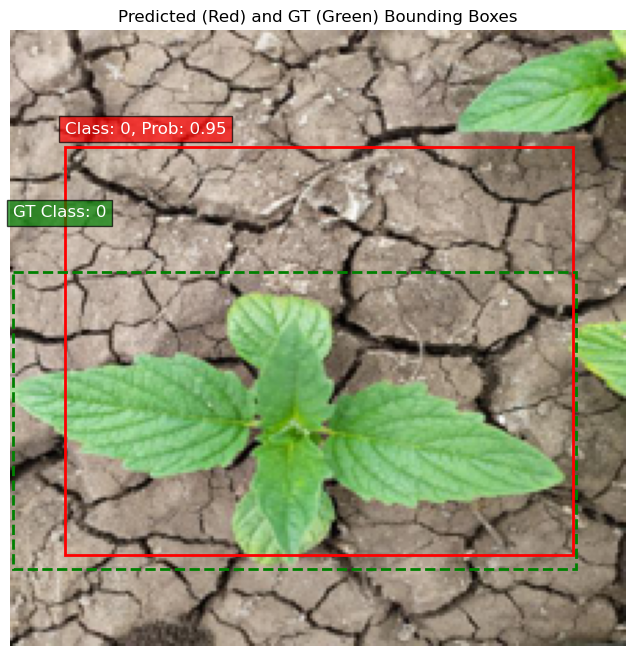

[0.49625516 0.5087924  0.84271693 0.8021498 ]
[0.492188 0.576172 0.921875 0.847656]


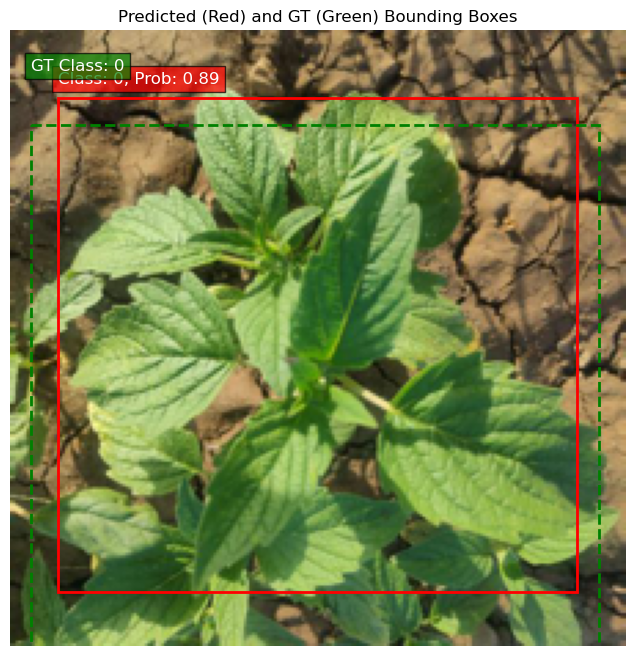

[0.5089816  0.49402606 0.5495845  0.52503884]
[0.483398 0.521484 0.580078 0.375   ]


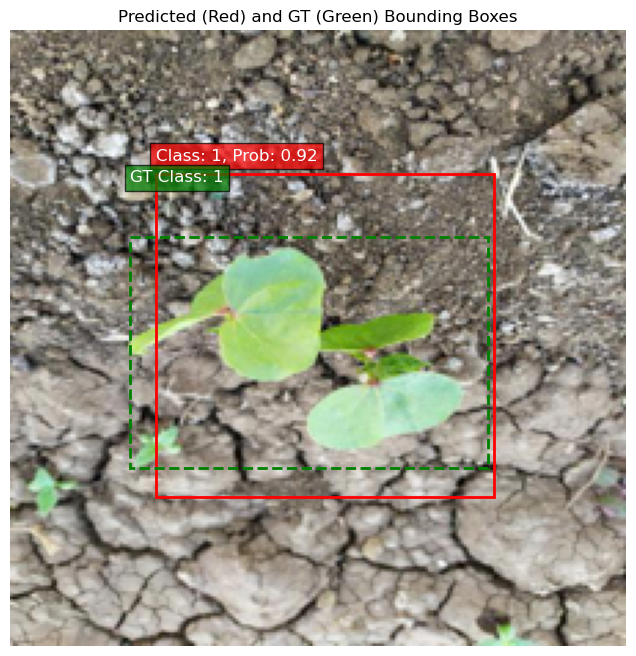

[0.5034661  0.53709257 0.846153   0.73902684]
[0.494141 0.53125  0.964844 0.78125 ]


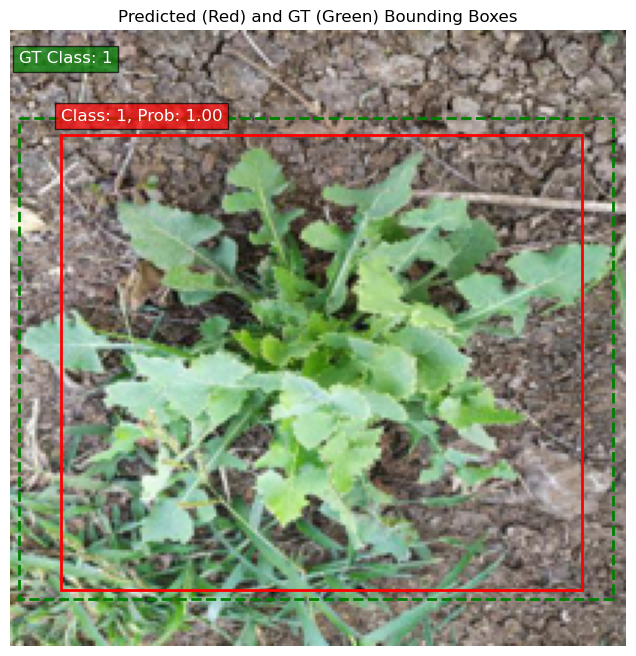

[0.5021791  0.49888924 0.79423755 0.6629308 ]
[0.537109 0.456055 0.765625 0.732422]


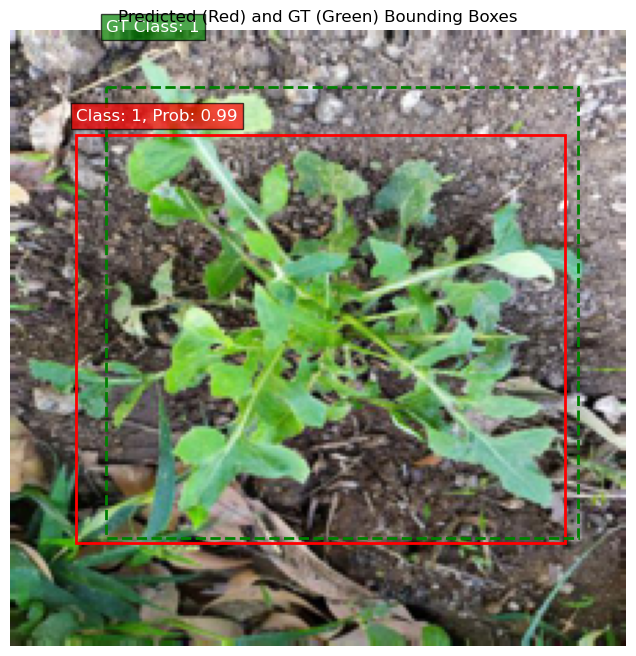

[0.5116553  0.5113071  0.83121866 0.6238374 ]
[0.500977 0.458984 0.966797 0.566406]


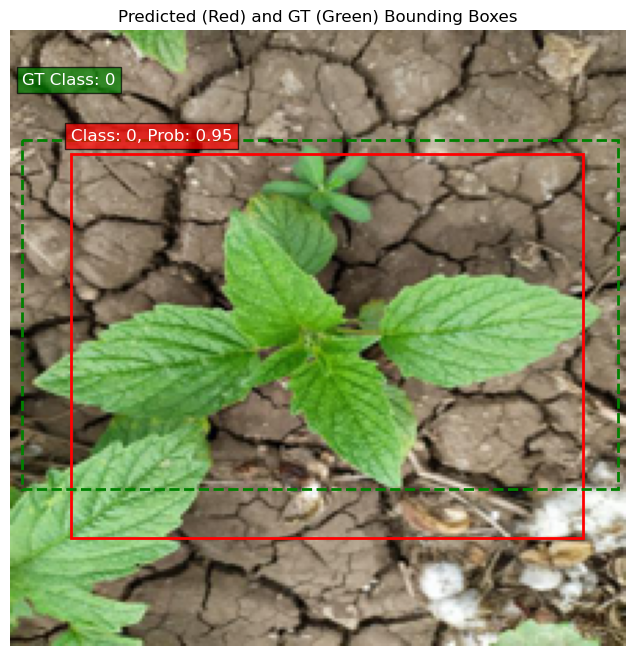

[0.51382554 0.50267065 0.962272   0.8800957 ]
[0.505859 0.428711 0.902344 0.724609]


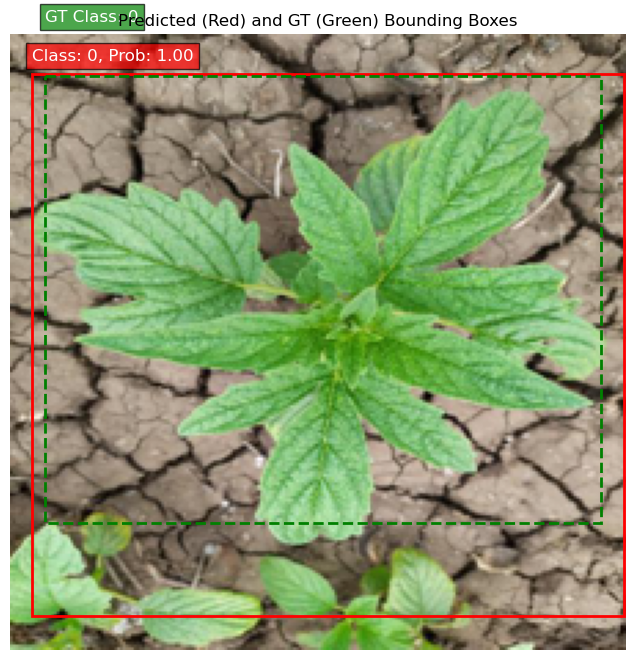

[0.49789515 0.4947563  0.81972533 0.7186875 ]
[0.435547 0.512695 0.824219 0.568359]


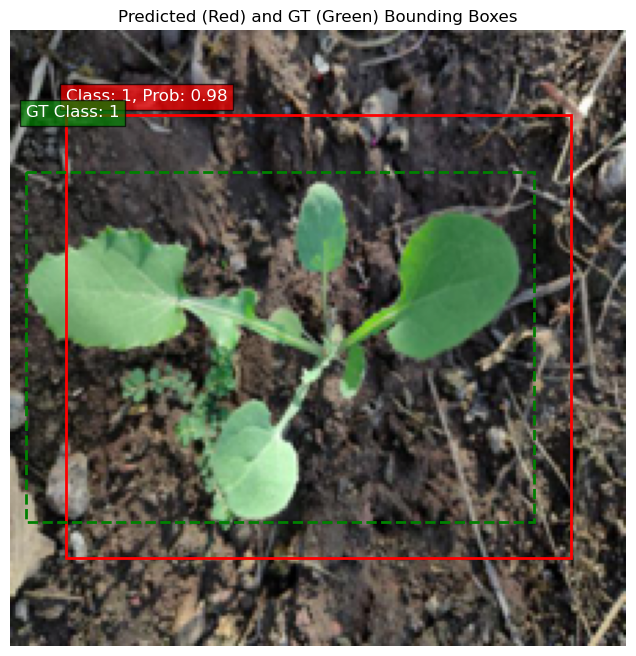

[0.5144752  0.49548298 0.5742844  0.5104244 ]
[0.451172 0.494141 0.449219 0.515625]


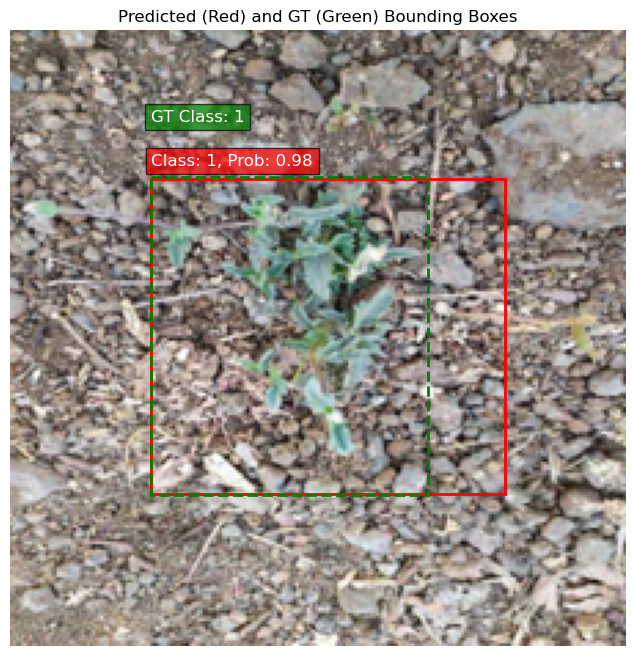

[0.50302994 0.50264585 0.93077123 0.8617656 ]
[0.511719 0.501953 0.96875  0.949219]


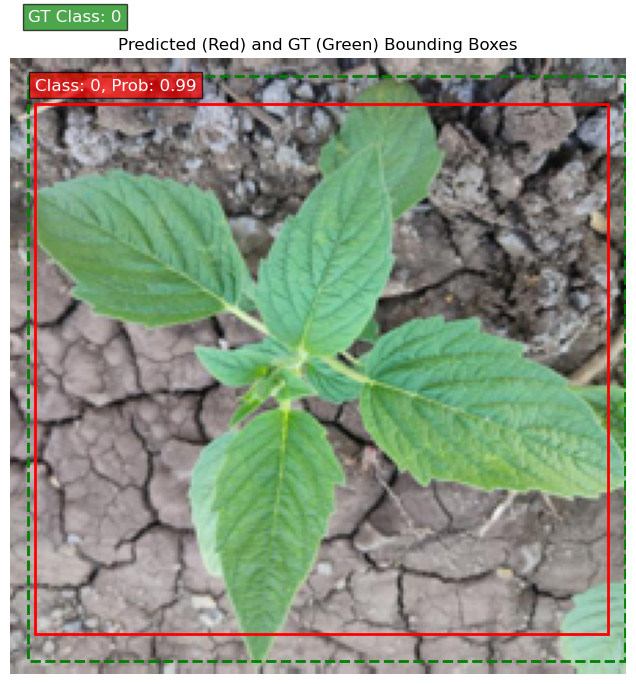

[0.51188046 0.4992852  0.56303245 0.51655984]
[0.548828 0.507812 0.769531 0.769531]


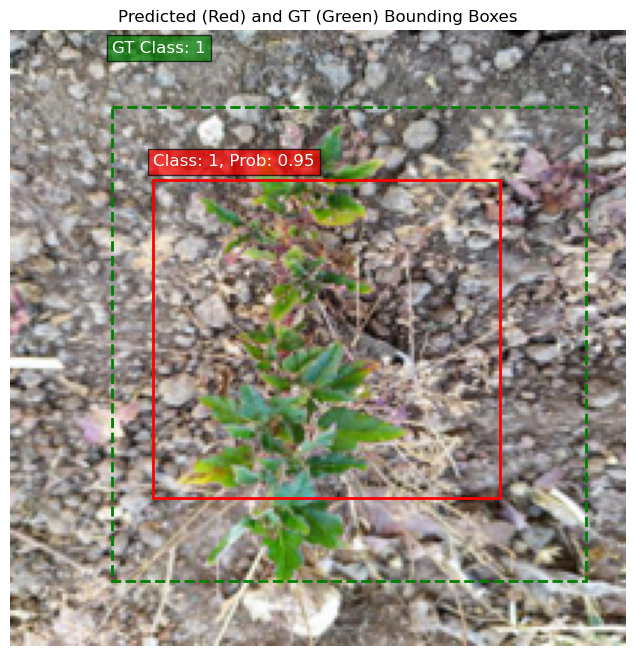

[0.49602723 0.5073684  0.8972058  0.825241  ]
[0.490234 0.501953 0.773438 0.992188]


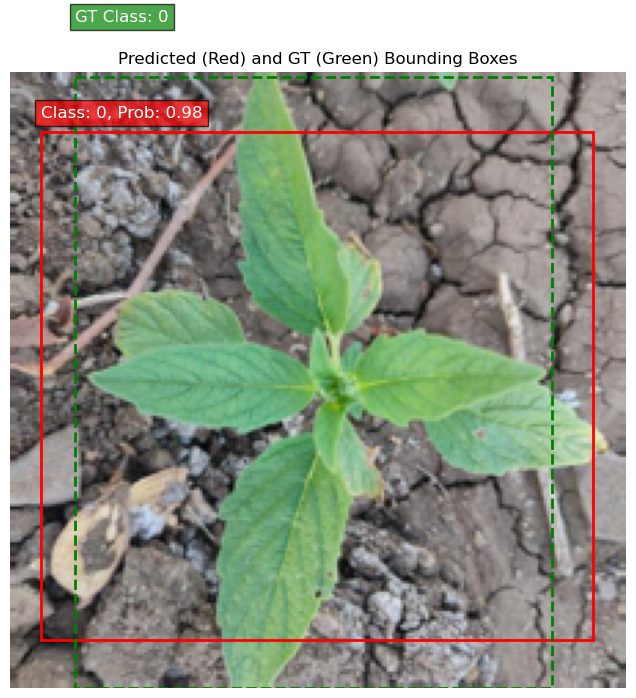

[0.497447   0.48487854 0.8131979  0.78189665]
[0.4375   0.459961 0.761719 0.892578]


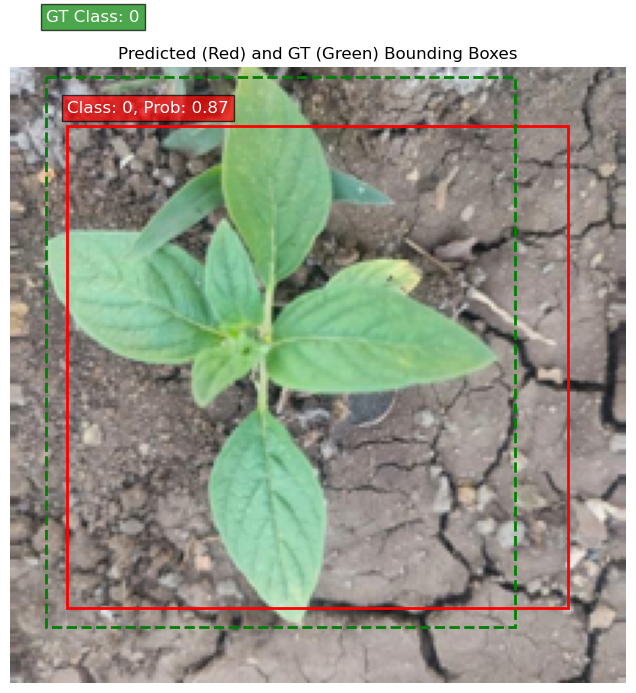

[0.50725925 0.48969164 0.5805236  0.55638945]
[0.40625  0.472656 0.671875 0.652344]


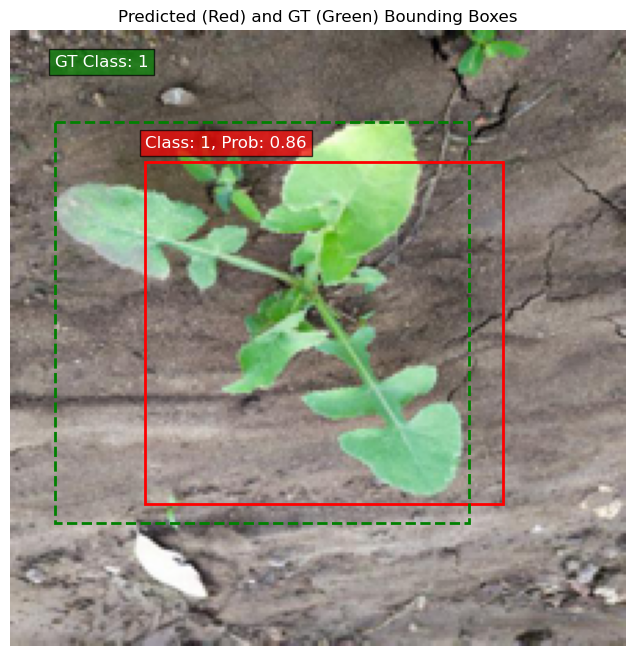


Confusion Matrix:
[[53  1]
 [ 1 51]]

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.98      0.98        54
     Class 1       0.98      0.98      0.98        52

    accuracy                           0.98       106
   macro avg       0.98      0.98      0.98       106
weighted avg       0.98      0.98      0.98       106



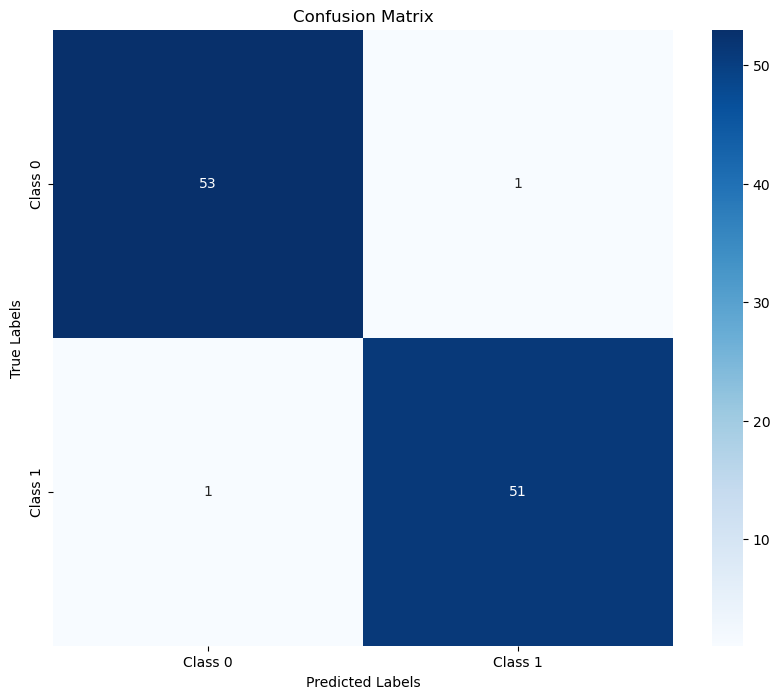

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│      test_bbox_loss       │    0.19126519560813904    │
│      test_class_loss      │    0.12402049452066422    │
│         test_loss         │    0.3152857720851898     │
└───────────────────────────┴───────────────────────────┘

[{'test_bbox_loss': 0.19126519560813904,
  'test_class_loss': 0.12402049452066422,
  'test_loss': 0.3152857720851898}]

In [23]:
# Prepare YOLO Dataset and DataLoader
def prepare_yolo_dataloader(base_dir, batch_size=16, num_workers=0):
    """
    Prepares DataLoaders for YOLO-style data with separate directories for train, val, and test.

    Args:
        base_dir (str): Path to the base directory containing train, val, and test directories.
        batch_size (int): Batch size for the DataLoader.
        num_workers (int): Number of workers for data loading.

    Returns:
        tuple: DataLoaders for train, validation, and test datasets.
    """
    # Define paths for train, val, and test datasets
    train_image_dir = os.path.join(base_dir, "train/images")
    train_label_dir = os.path.join(base_dir, "train/labels")
    val_image_dir = os.path.join(base_dir, "val/images")
    val_label_dir = os.path.join(base_dir, "val/labels")
    test_image_dir = os.path.join(base_dir, "test/images")
    test_label_dir = os.path.join(base_dir, "test/labels")

    # Create datasets
    train_dataset = SingleBoundingBoxDataset(train_image_dir, train_label_dir, transform=transform)
    val_dataset = SingleBoundingBoxDataset(val_image_dir, val_label_dir, transform=transform)
    test_dataset = SingleBoundingBoxDataset(test_image_dir, test_label_dir, transform=transform)

    # Create DataLoaders
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=num_workers)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=num_workers)
    test_loader = DataLoader(test_dataset, batch_size=1, shuffle=False, num_workers=num_workers)

    return train_loader, val_loader, test_loader


# Training Configuration
base_dir = "/Users/mepercuter/Desktop/kaggle_crops/archive/yolo_data"
train_loader, val_loader, test_loader = prepare_yolo_dataloader(base_dir)

# Model Training
model = BoundingBoxCNN()
trainer = Trainer(max_epochs=30, callbacks=[
    ModelCheckpoint(monitor="val_loss", save_top_k=1, mode="min"),
    EarlyStopping(monitor="val_loss", patience=3, mode="min")
])
trainer.fit(model, train_loader, val_loader)

# Save the Model
torch.save(model.state_dict(), "bounding_box_cnn.pt")

trainer.test(model, test_loader)

/Users/mepercuter/miniforge3/envs/mlp/lib/python3.8/site-packages/torch/nn/modules/module.py:1117: UserWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  warnings.warn("Using a non-full backward hook when the forward contains multiple autograd Nodes "
/Users/mepercuter/miniforge3/envs/mlp/lib/python3.8/site-packages/torch/nn/functional.py:1967: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


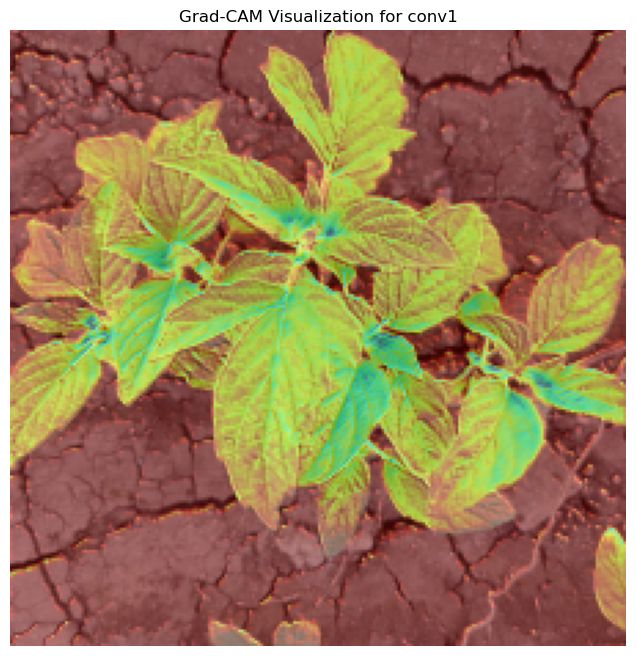

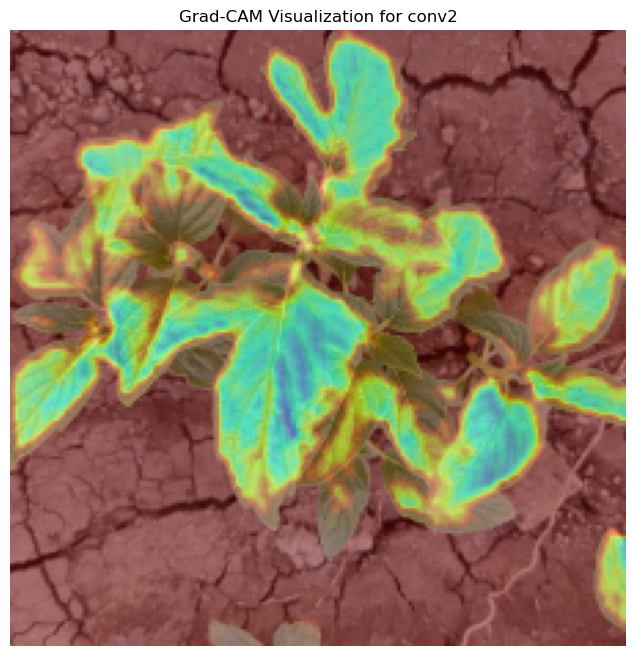

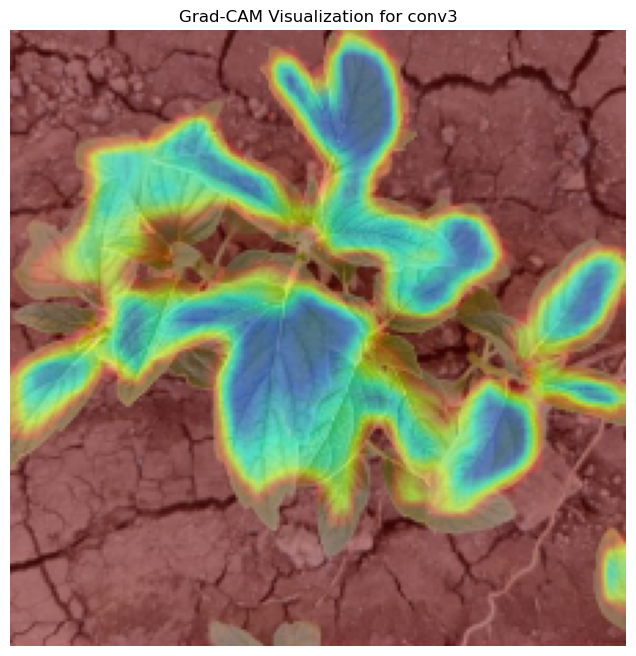

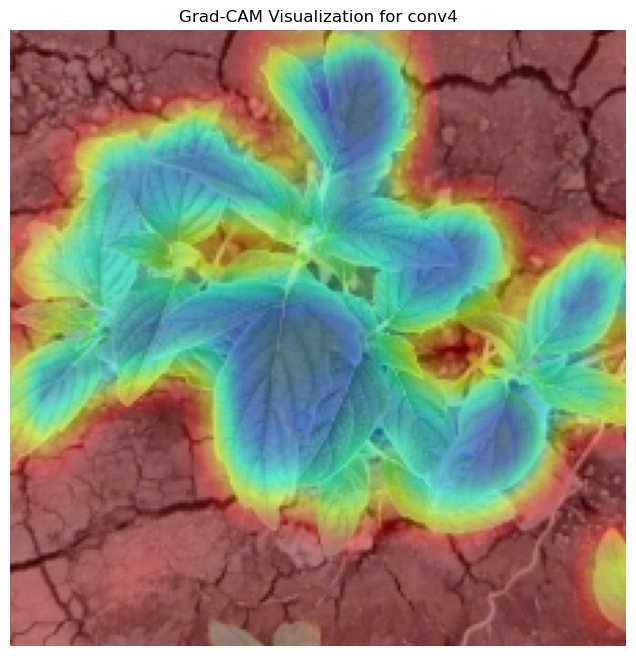

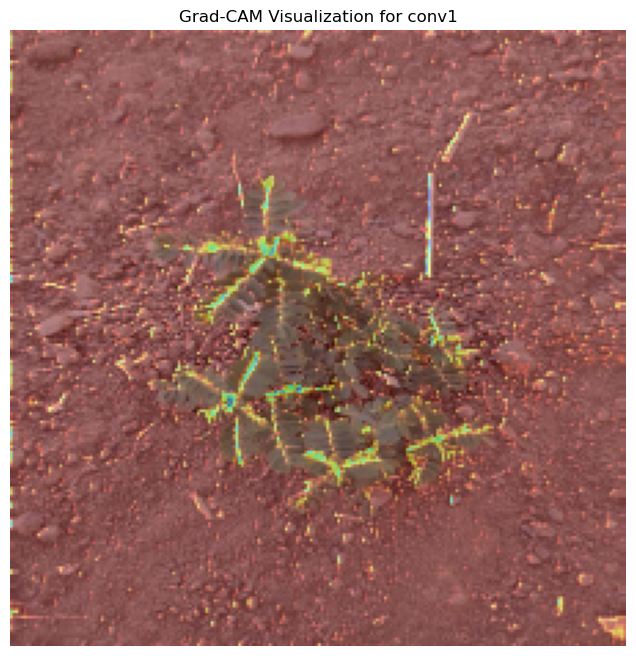

...

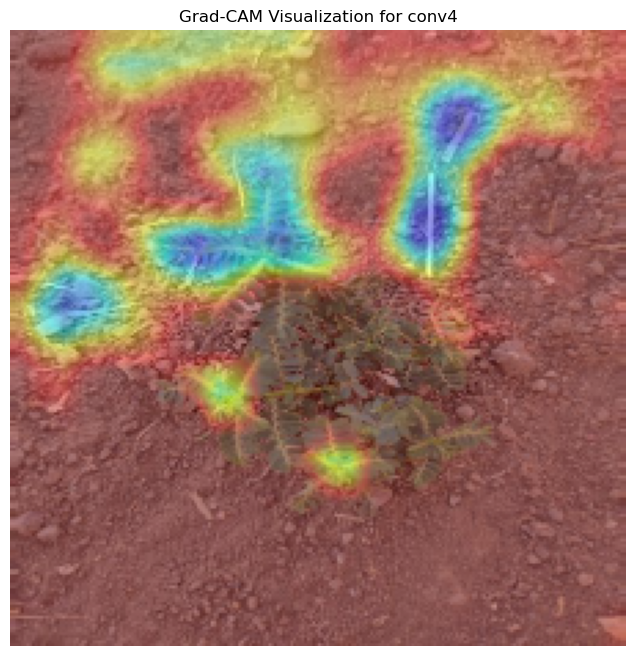

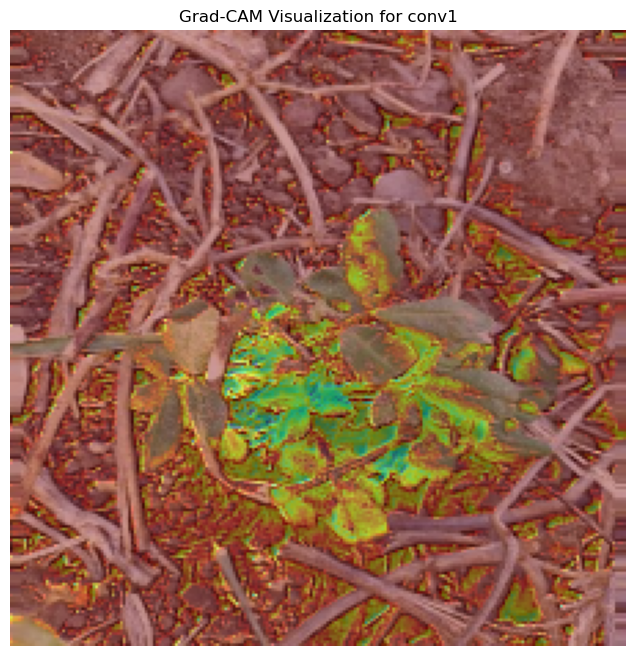

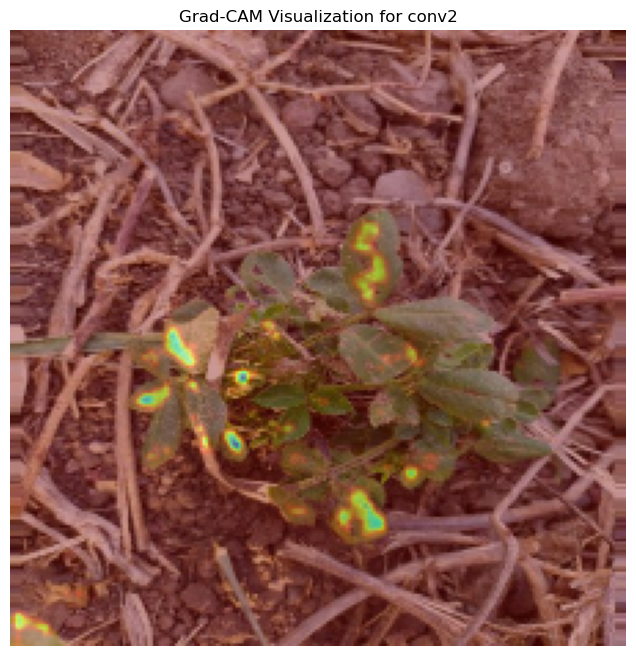

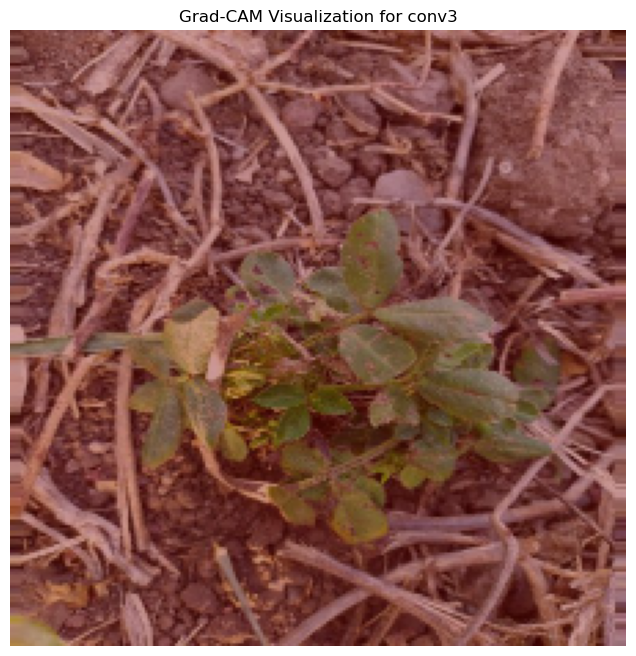

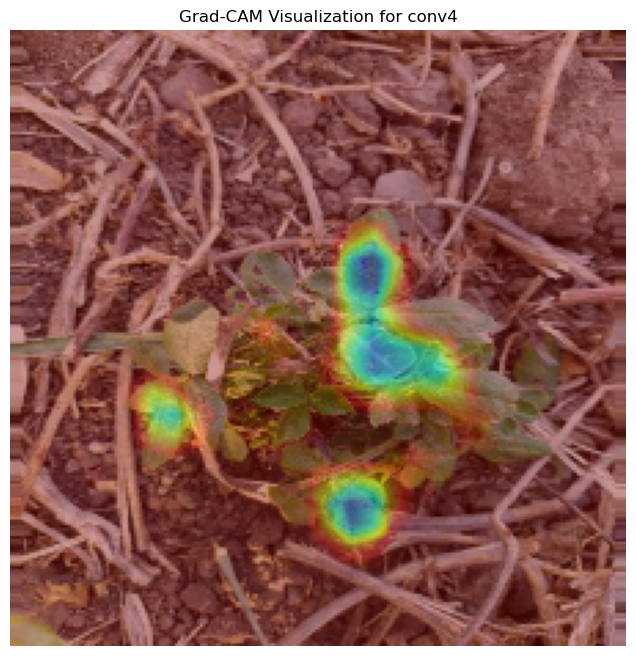

In [4]:
import cv2
import torch
import numpy as np
import matplotlib.pyplot as plt
from torchvision.transforms import Normalize, ToTensor

def preprocess_image(image_path, img_size, mean, std):
    """
    Preprocess the image to prepare it for the model.
    Args:
        image_path (str): Path to the input image.
        img_size (tuple): Desired size for the input image (H, W).
        mean (list): Mean for normalization.
        std (list): Std for normalization.
    Returns:
        input_tensor (torch.Tensor): Preprocessed image tensor [1, 3, H, W].
    """
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    image = cv2.resize(image, img_size)

    # Convert to tensor and normalize
    transform = Normalize(mean=mean, std=std)
    input_tensor = ToTensor()(image)
    input_tensor = transform(input_tensor).unsqueeze(0)
    return input_tensor, image  # Return both tensor and original image for visualization

def generate_gradcam(model, input_tensor, target_class, target_layer):
    """
    Generate Grad-CAM heatmap for the target class.
    
    Args:
        model: Trained PyTorch model.
        input_tensor (torch.Tensor): Input image tensor [1, 3, H, W].
        target_class (int): Target class index.
        target_layer (str): Name of the layer for Grad-CAM.
    Returns:
        heatmap (numpy.ndarray): Grad-CAM heatmap.
    """
    # Forward hook to capture activations
    activations = {}
    def forward_hook(module, input, output):
        activations["value"] = output

    # Backward hook to capture gradients
    gradients = {}
    def backward_hook(module, grad_input, grad_output):
        gradients["value"] = grad_output[0]

    # Register hooks
    target_module = dict(model.named_modules())[target_layer]
    target_module.register_forward_hook(forward_hook)
    target_module.register_backward_hook(backward_hook)

    # Forward pass
    model.eval()
    bbox_preds, class_logits = model(input_tensor)

    # Backward pass for the target class
    class_score = class_logits[:, target_class].sum()
    model.zero_grad()
    class_score.backward(retain_graph=True)

    # Get gradients and activations
    grads = gradients["value"]
    acts = activations["value"]

    # Global average pooling of gradients
    pooled_grads = torch.mean(grads, dim=[0, 2, 3])

    # Weight activations by gradients
    for i in range(acts.shape[1]):
        acts[:, i, :, :] *= pooled_grads[i]

    # Compute Grad-CAM
    heatmap = torch.mean(acts, dim=1).squeeze().cpu().detach().numpy()
    heatmap = np.maximum(heatmap, 0)  # ReLU
    if np.max(heatmap) > 0:
        heatmap /= np.max(heatmap)  # Normalize to [0, 1]
    return heatmap, bbox_preds, class_logits

def visualize_gradcam(input_image, heatmap, layer_name):
    """
    Overlay Grad-CAM heatmap on the original image.
    
    Args:
        input_image (numpy.ndarray): Original image in HWC format.
        heatmap (numpy.ndarray): Grad-CAM heatmap.
        layer_name (str): Layer name for visualization.
    """
    # Resize heatmap to match image size
    heatmap_resized = cv2.resize(heatmap, (input_image.shape[1], input_image.shape[0]))
    heatmap_resized = np.uint8(255 * heatmap_resized)
    heatmap_colored = cv2.applyColorMap(heatmap_resized, cv2.COLORMAP_JET)

    # Overlay heatmap on the image
    overlayed_image = cv2.addWeighted(input_image, 0.6, heatmap_colored, 0.4, 0)

    # Plot the image with Grad-CAM
    plt.figure(figsize=(8, 8))
    plt.imshow(overlayed_image)
    plt.axis("off")
    plt.title(f"Grad-CAM Visualization for {layer_name}")
    plt.show()

def visualize_gradcam_conv_layers(model, image_path, target_class, mean, std, img_size):
    """
    Visualize Grad-CAM for all convolutional layers in the model.
    
    Args:
        model: Trained PyTorch model.
        image_path (str): Path to the input image.
        target_class (int): Target class index.
        mean (list): Mean for normalization.
        std (list): Std for normalization.
        img_size (tuple): Desired size for the input image (H, W).
    """
    # Preprocess the image
    input_tensor, original_image = preprocess_image(image_path, img_size, mean, std)

    # Get all convolutional layer names
    conv_layers = [name for name, module in model.named_modules() if isinstance(module, torch.nn.Conv2d)]

    # Generate and visualize Grad-CAM for each convolutional layer
    for layer_name in conv_layers:
        try:
            heatmap, _, _ = generate_gradcam(model, input_tensor, target_class, layer_name)
            visualize_gradcam(original_image, heatmap, layer_name)
        except Exception as e:
            print(f"Skipping layer {layer_name}: {e}")


image_path = "/Users/mepercuter/Desktop/kaggle_crops/archive/yolo_data/test/images/agri_0_2271.jpeg" 
mean = [0.485, 0.456, 0.406]
std = [0.229, 0.224, 0.225]
target_class = 0 
img_size = (224, 224)

visualize_gradcam_conv_layers(model, image_path, target_class, mean, std, img_size)

target_class = 0

image_path = "/Users/mepercuter/Desktop/kaggle_crops/archive/yolo_data/test/images/agri_0_8393.jpeg"

visualize_gradcam_conv_layers(model, image_path, target_class, mean, std, img_size)

image_path = "/Users/mepercuter/Desktop/kaggle_crops/archive/yolo_data/test/images/agri_0_7105.jpeg"

visualize_gradcam_conv_layers(model, image_path, target_class, mean, std, img_size)
